# Benchmarking spatial mapping of cell types in the LN

## Loading packages

In [1]:
import sys
import pickle
import scanpy as sc
import anndata
import numpy as np
import os
import pandas as pd

sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/BayraktarLab/cell2location/')
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/cell2location_dev/')

import cell2location

import matplotlib as mpl
from matplotlib import pyplot as plt

# scanpy prints a lot of warnings
import warnings
warnings.filterwarnings('ignore')

WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [2]:
cell2location

<module 'cell2location' from '/nfs/team205/vk7/sanger_projects/BayraktarLab/cell2location/cell2location/__init__.py'>

## 1. Loading cell2location results <a name="loading"></a>

In [3]:
# read a previously trained LocationModel
results_folder = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/lymph_nodes_analysis/'
sp_results_folder = f'{results_folder}'
sc_results_folder = f'{results_folder}regression_model/'

run_name = 'CoLocationModelNB4V2_34clusters_4039locations_10241genes_input_inferred_V4_batch1024_l2_0001_n_comb50_5_cps5_fpc3_alpha001'

# path for saving figures
fig_path = f'{sp_results_folder}{run_name}/plots/figures/'
sc_figpath = sc.settings.figdir
sc.settings.figdir = f'{fig_path}'

sp_data_file = f'{sp_results_folder}{run_name}/sp_with_clusters.h5ad'
adata_vis = anndata.read(sp_data_file)

adata_vis.obs[adata_vis.uns['mod']['fact_names']] = adata_vis.uns['mod']['post_sample_q05']['spot_factors']

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


## 2. Loading gold standard annotations results <a name="loading2"></a>

In [4]:
# read region annotation for each location
manual_GC_annot = pd.read_csv(f'{sp_results_folder}{run_name}/manual_GC_annot.csv', index_col=0)
manual_GC_annot['GC'][manual_GC_annot['GC'].isna()] = 'other'
manual_GC_annot['GC'].value_counts()

other    3657
GC        378
Name: GC, dtype: int64

In [5]:
ind = manual_GC_annot.index.isin(adata_vis.obs_names)
ind = manual_GC_annot.index[ind]
adata_vis = adata_vis[ind,:]
adata_vis.obs['supervised_region'] = manual_GC_annot.loc[ind, 'GC']

# remove other group
#adata_vis = adata_vis[~adata_vis.obs['supervised_region'].isin(['other']),:]

# read region annotations for each cell type
gold_standard = pd.read_csv(f'{sp_results_folder}{run_name}/gold_standard_annotation_subtypes_to_regions.csv',
                            index_col=0)
gold_standard = gold_standard.loc[gold_standard.isna().sum(1) == 0,]
gold_standard.index = [f'gold_standard_{i}' for i in gold_standard.index]

# remove other group
gold_standard = gold_standard.loc[~gold_standard['label'].isin(['other', 'T-cell zone']),:]

for ct in gold_standard.index:
    adata_vis.obs[ct] = adata_vis.obs['supervised_region'].isin([gold_standard.loc[ct, 'label']]).astype(float)
    
adata_vis.obs[gold_standard.index]

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


,gold_standard_B_Cycling,gold_standard_B_GC_DZ,gold_standard_B_GC_LZ,gold_standard_B_GC_prePB,gold_standard_FDC,gold_standard_T_CD4+_TfH_GC
AAACAAGTATCTCCCA-1,0.0,0.0,0.0,0.0,0.0,0.0
AAACAATCTACTAGCA-1,0.0,0.0,0.0,0.0,0.0,0.0
AAACACCAATAACTGC-1,0.0,0.0,0.0,0.0,0.0,0.0
AAACAGAGCGACTCCT-1,0.0,0.0,0.0,0.0,0.0,0.0
AAACAGCTTTCAGAAG-1,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...
TTGTTTCACATCCAGG-1,0.0,0.0,0.0,0.0,0.0,0.0
TTGTTTCATTAGTCTA-1,0.0,0.0,0.0,0.0,0.0,0.0
TTGTTTCCATACAACT-1,0.0,0.0,0.0,0.0,0.0,0.0
TTGTTTGTATTACACG-1,0.0,0.0,0.0,0.0,0.0,0.0


... storing 'supervised_region' as categorical


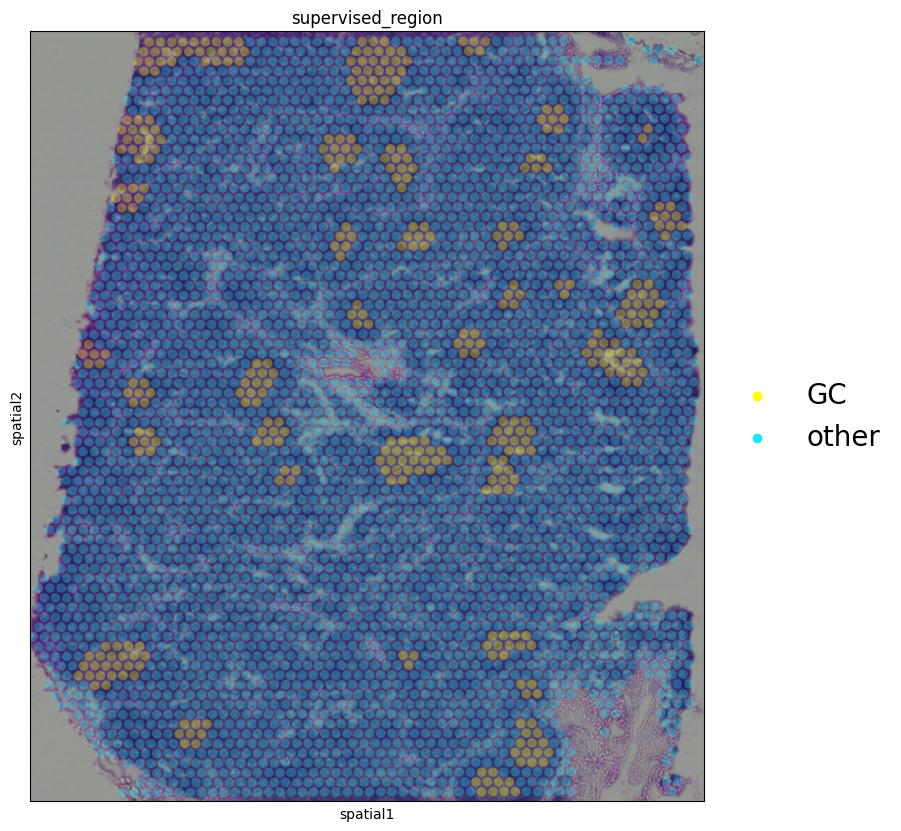

In [6]:
crop_x = [230, 1640]
crop_y = [150, 1760]

max_y = list(adata_vis.uns['spatial'].values())[0]['images']['hires'].shape[1]
crop_y = [max_y - i + 80 for i in crop_y]

mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (10, 10), 'axes.facecolor': "black"}):
    sc.pl.spatial(adata_vis, cmap='magma',
                  color=['supervised_region'], ncols=4, 
                  size=1.3, img_key='hires', 
                  alpha_img=1, alpha=0.3,
                  frameon=True, legend_fontsize=20,
                  crop_coord=crop_x + [crop_y[0]] + [crop_y[1]],
                  vmin=0, vmax='p99.5', save='benchmark_supervised_region.pdf',
                  palette=sc.pl.palettes.default_102
                 )

## Compare methods using PR-curves

In [7]:
import matplotlib as mpl
from matplotlib import pyplot as plt
import numpy as np
from scipy import interpolate

with plt.style.context('seaborn'):
    seaborn_colors = mpl.rcParams['axes.prop_cycle'].by_key()['color']


def compute_precision_recall(pos_cell_count, infer_cell_proportions, mode='macro'):
    r""" Plot precision-recall curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells)
    """
    
    from sklearn.metrics import precision_recall_curve
    from sklearn.metrics import average_precision_score
    
    ### calculating ###
    predictor = infer_cell_proportions.values + np.random.gamma(20, 1e-12, 
                                                                infer_cell_proportions.shape)
    # For each cell type
    precision = dict()
    recall = dict()
    average_precision = dict()
    for i, c in enumerate(infer_cell_proportions.columns):
        precision[c], recall[c], _ = precision_recall_curve(pos_cell_count[:, i],
                                                            predictor[:, i])
        average_precision[c] = average_precision_score(pos_cell_count[:, i], predictor[:, i], average=mode)

    average_precision["averaged"] = average_precision_score(pos_cell_count, predictor,
                                                     average=mode)

    # A "micro-average": quantifying score on all classes jointly
    if mode == 'micro':
        precision_, recall_, threshold = precision_recall_curve(pos_cell_count.ravel(),
                                                                        predictor.ravel())
        #precision_[threshold < 0.1] = 0
        precision["averaged"], recall["averaged"] =  precision_, recall_

    elif mode == 'macro':
        precisions = []
        recall_grid = np.linspace(0, 1, 2000)

        for i, c in enumerate(infer_cell_proportions.columns):
            f = interpolate.interp1d(recall[c], precision[c])
            precision_interp = f(recall_grid)
            precisions.append(precision_interp)

        precision["averaged"] = np.mean(precisions, axis=0)
        recall['averaged'] = recall_grid

        
    return precision, recall, average_precision

def compute_roc(pos_cell_count, infer_cell_proportions, mode='macro'):
    r""" Plot ROC curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells)
    """
    
    from sklearn.metrics import roc_curve
    from sklearn.metrics import roc_auc_score
    
    ### calculating ###
    predictor = infer_cell_proportions.values + np.random.gamma(20, 1e-12, 
                                                                infer_cell_proportions.shape)
    # For each cell type
    precision = dict()
    recall = dict()
    average_precision = dict()
    for i, c in enumerate(infer_cell_proportions.columns):
        precision[c], recall[c], _ = roc_curve(pos_cell_count[:, i],
                                                            predictor[:, i])
        average_precision[c] = roc_auc_score(pos_cell_count[:, i], predictor[:, i], average=mode)

    average_precision["averaged"] = roc_auc_score(pos_cell_count, predictor,
                                                     average=mode)

    # A "micro-average": quantifying score on all classes jointly
    if mode == 'micro':
        precision_, recall_, threshold = roc_curve(pos_cell_count.ravel(),
                                                                        predictor.ravel())
        #precision_[threshold < 0.1] = 0
        precision["averaged"], recall["averaged"] =  precision_, recall_

    elif mode == 'macro':
        precisions = []
        recall_grid = np.linspace(0, 1, 2000)

        for i, c in enumerate(infer_cell_proportions.columns):
            f = interpolate.interp1d(recall[c], precision[c])
            precision_interp = f(recall_grid)
            precisions.append(precision_interp)

        precision["averaged"] = np.mean(precisions, axis=0)
        recall['averaged'] = recall_grid

        
    return precision, recall, average_precision

def plot_precision_recall(pos_cell_count, infer_cell_proportions,
                          title='', iso_f1_curves=False,
                          individual_cell_types=True,
                          save=None, mode='macro', curve='PR'):
    r""" Plot precision-recall curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells)
    :param title: plot title
    :param iso_f1_curves: plot iso curves for F1 score?
    :param individual_cell_types: show precision-recall curves for each cell type?
    """
    
    ### calculating ###
    if curve == 'PR':
        precision, recall, average_precision = compute_precision_recall(pos_cell_count, 
                                                                        infer_cell_proportions, 
                                                                        mode=mode)
        xlabel = 'Recall'
        ylabel = 'Precision'
        
    elif curve == 'ROC':
        recall, precision, average_precision = compute_roc(pos_cell_count, 
                                                                        infer_cell_proportions, 
                                                                        mode=mode)
        xlabel = 'FPR'
        ylabel = 'TPR'
        
    ### plotting ###
    from itertools import cycle
    # setup plot details
    colors = cycle(['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal'])

    lines = []
    labels = []
    
    if iso_f1_curves:
        f_scores = np.linspace(0.2, 0.8, num=4)
        
        for f_score in f_scores:
            x = np.linspace(0.01, 1)
            y = f_score * x / (2 * x - f_score)
            l, = plt.plot(x[y >= 0], y[y >= 0], color='gray', alpha=0.2)
            plt.annotate('f1={0:0.1f}'.format(f_score), xy=(0.9, y[45] + 0.02))

        lines.append(l)
        labels.append('iso-f1 curves')
    
    l, = plt.plot(recall["averaged"], precision["averaged"], color='navy', lw=2)
    lines.append(l)
    labels.append(f'{mode}-average {curve} (area = {round(average_precision["averaged"], 2)})')

    if individual_cell_types:
        for i, color in zip(infer_cell_proportions.columns, colors):
            l, = plt.plot(recall[i], precision[i], color='gold', lw=1)
            lines.append(l)
        labels.append(f'{curve} for individual cell types')



    fig = plt.gcf()
    fig.subplots_adjust(bottom=0.25)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend(lines, labels, loc=(0, -.37), prop=dict(size=8))
    
    if save is not None:
        plt.savefig(save)

def compare_precision_recall(pos_cell_count, infer_cell_proportions,
                             method_title, title='',
                             legend_loc=(0, -.37),
                             colors=sc.pl.palettes.default_102,
                             mode='macro', curve='PR'):
    
    r""" Plot precision-recall curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells), 
                                        list of inferred parameters for several methods
    :param method_title: title for each infer_cell_proportions
    :param title: plot title
    """
    # setup plot details
    from itertools import cycle
    colors = cycle(colors)
    lines = []
    labels = []
    roc = {}
    
    ### plotting ###
    for i, color in zip(range(len(infer_cell_proportions)), colors):
        
        if curve == 'PR':
            precision, recall, average_precision = compute_precision_recall(pos_cell_count, 
                                                                        infer_cell_proportions[i], 
                                                                        mode=mode)

            xlabel = 'Recall'
            ylabel = 'Precision'
            
            l, = plt.plot(recall["averaged"], precision["averaged"], color=color, lw=3)

        elif curve == 'ROC':
            FPR, TPR, average_precision = compute_roc(pos_cell_count, 
                                                                        infer_cell_proportions[i], 
                                                                        mode=mode)

            xlabel = 'FPR'
            ylabel = 'TPR'
            
            l, = plt.plot(FPR["averaged"], TPR["averaged"], color=color, lw=3)
            
        
        lines.append(l)

        labels.append(method_title[i] + ' (area = {0:0.2f})'
                      ''.format(average_precision["averaged"]))
        roc[method_title[i]] = average_precision["averaged"]


    fig = plt.gcf()
    fig.subplots_adjust(bottom=0.25)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    if legend_loc is not None:
        plt.legend(lines, labels, loc=legend_loc, prop=dict(size=14))

    #plt.show()
    return roc

In [8]:
from re import sub
col_ind = [sub('gold_standard_','',i) for i in gold_standard.index]

In [9]:
results_folder_st = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/benchmarking/lymph_nodes_analysis/'
RCTD = pd.read_csv(f'{results_folder_st}rctd/results_weights_59clusters_2128genes_6156genes.csv',
                   index_col='spot')
adata_vis = adata_vis[adata_vis.obs_names.isin(RCTD.index),:]

# compute cell proportions
RCTD = (RCTD.T / RCTD.sum(1)).T
RCTD = RCTD.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'RCTD_{i}' for i in RCTD.columns]] = RCTD.values

results = [RCTD[col_ind]]
names = ['RCTD']

Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [10]:
scvi_stereoscope = anndata.read(f'{results_folder_st}scvi_stereoscope/sp_20k.h5ad')

scvi_stereoscope = scvi_stereoscope.obsm['decomposition'].copy()
scvi_stereoscope = (scvi_stereoscope.T / scvi_stereoscope.sum(1)).T
scvi_stereoscope = scvi_stereoscope.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'scVI_Stereoscope_{i}' for i in scvi_stereoscope.columns]] = scvi_stereoscope.values

results = results + [scvi_stereoscope[col_ind]]
names = names + ['scVI_Stereoscope']

In [11]:
results_folder_st = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/benchmarking/lymph_nodes_analysis/'

SeuratV3 = pd.read_csv(f'{results_folder_st}seurat_new/results_pca.csv',
                       index_col='spot')
SeuratV3 = SeuratV3.drop(columns=['prediction.score.max', 'Unnamed: 0', 'predicted.id'])
from re import sub
SeuratV3.columns = [sub('prediction.score.', '',i) for i in SeuratV3.columns]
SeuratV3.columns = [sub('CD4\.', 'CD4+',i) for i in SeuratV3.columns]
SeuratV3.columns = [sub('CD8\.', 'CD8+',i) for i in SeuratV3.columns]
SeuratV3.columns = [sub('CCR7\.', 'CCR7+',i) for i in SeuratV3.columns]

# compute cell proportions
SeuratV3 = (SeuratV3.T / SeuratV3.sum(1)).T
SeuratV3 = SeuratV3.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'Seurat_{i}' for i in SeuratV3.columns]] = SeuratV3.values

results = results + [SeuratV3[col_ind]]
names = names + ['Seurat']

In [12]:
results_folder_st = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/benchmarking/lymph_nodes_analysis/'

SPOTlight = pd.read_csv(f'{results_folder_st}SPOTlight/results_hvg5k.csv',
                       index_col='rn')
SPOTlight = SPOTlight.drop(columns=['res_ss'])
from re import sub
SPOTlight.columns = [sub('\.', '_',i) for i in SPOTlight.columns]
SPOTlight.columns = [sub('CD4_', 'CD4+',i) for i in SPOTlight.columns]
SPOTlight.columns = [sub('CD8_', 'CD8+',i) for i in SPOTlight.columns]
SPOTlight.columns = [sub('CCR7_', 'CCR7+',i) for i in SPOTlight.columns]

# compute cell proportions
SPOTlight = (SPOTlight.T / SPOTlight.sum(1)).T
SPOTlight[SPOTlight.isna()] = 0

SPOTlight = SPOTlight.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'SPOTlight_{i}' for i in SPOTlight.columns]] = SPOTlight.values

results = results + [SPOTlight[col_ind]]
names = names + ['SPOTlight']

In [13]:
results_folder_st = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/benchmarking/lymph_nodes_analysis/'

nnls = pd.read_csv(f'{results_folder_st}autogenes_models/coef_nnls_seed.csv', index_col=0).T

# compute cell proportions
nnls = (nnls.T / nnls.sum(1)).T
nnls[nnls.isna()] = 0

nnls = nnls.loc[adata_vis.obs_names,:]

adata_vis.obs[[f'NNSL_{i}' for i in nnls.columns]] = nnls.values

results = results + [nnls[col_ind]]
names = names + ['NNSL']

In [14]:
pos_cell_count = adata_vis.obs[gold_standard.index].values

cell2loc = adata_vis.obs[adata_vis.uns['mod']['fact_names']]
cell2loc = (cell2loc.T / cell2loc.sum(1)).T

adata_vis.obs[[f'cell2location_{i}' for i in cell2loc.columns]] = cell2loc.values

results =  [cell2loc[col_ind]] + results
names = ['cell2location'] + names

In [15]:
fig_path

'/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/lymph_nodes_analysis/CoLocationModelNB4V2_34clusters_4039locations_10241genes_input_inferred_V4_batch1024_l2_0001_n_comb50_5_cps5_fpc3_alpha001/plots/figures/'

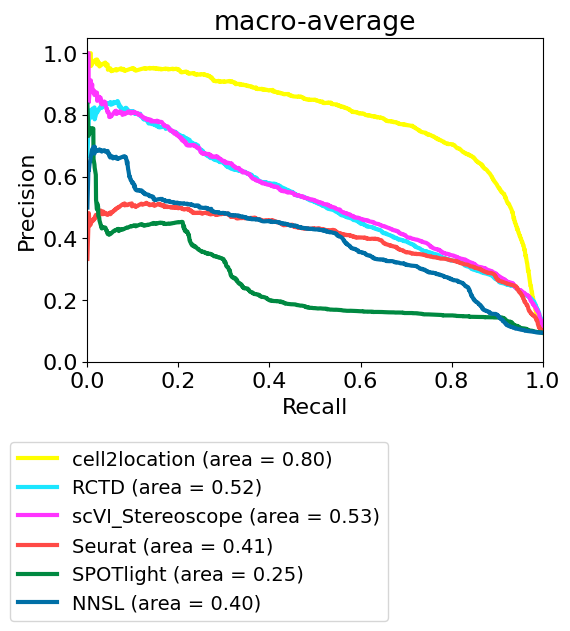

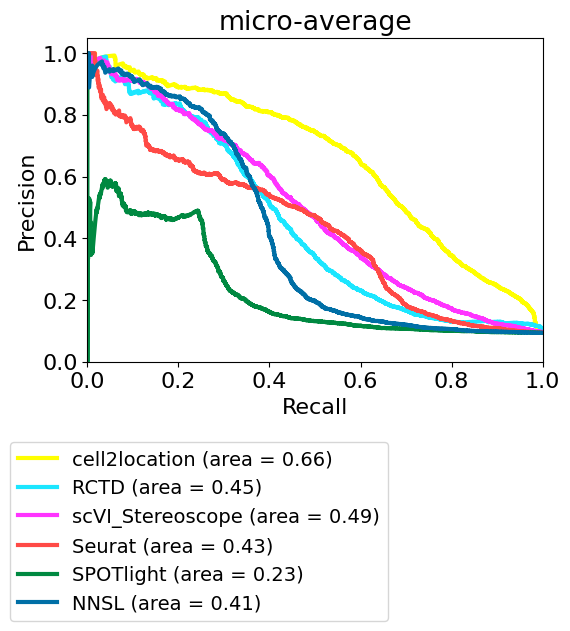

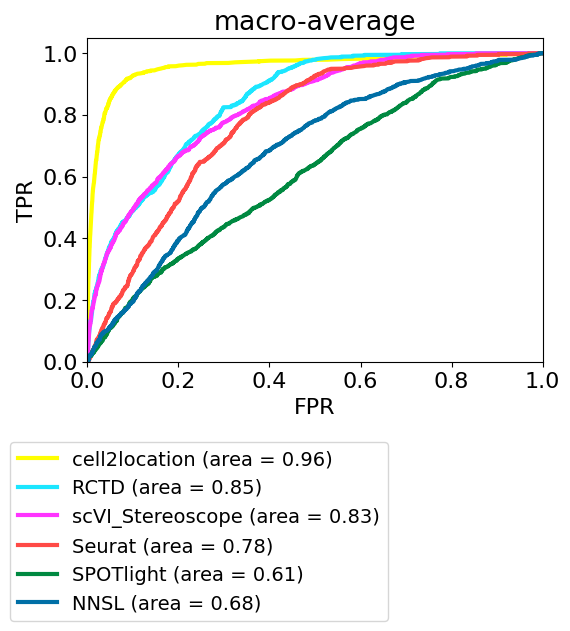

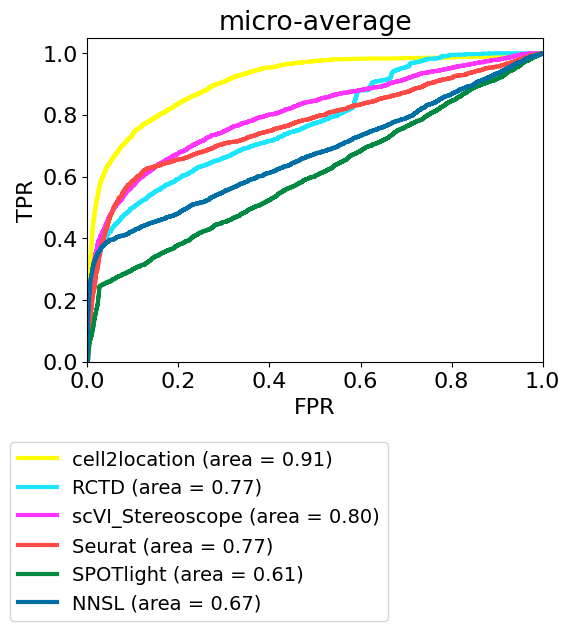

In [16]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (6,7.5), 'font.size': 16}):
    
    for c in ['PR', 'ROC']:
        for m in ['macro', 'micro']:
            compare_precision_recall(pos_cell_count, results,
                                     method_title=names, 
                                     legend_loc=(-0.17, -0.8),
                                     mode=m, curve=c)#,
                                     #colors=['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal'])
            plt.tight_layout()
            plt.title(f'{m}-average')
            plt.savefig(f'{fig_path}/{c}_comparison_all_{m}average.pdf')
            plt.show()

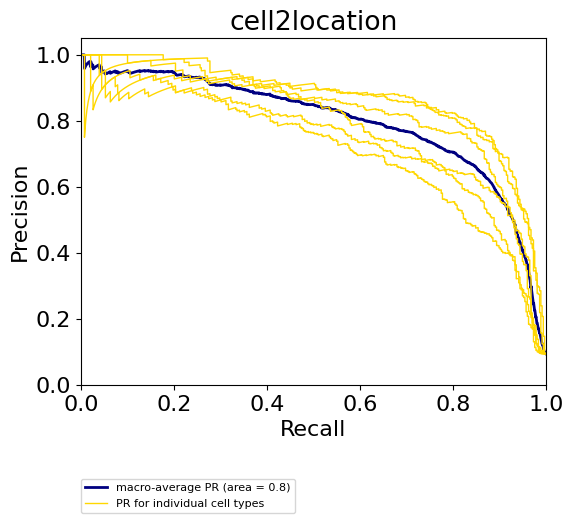

In [17]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (6,5.5), 'font.size': 16}):
    plot_precision_recall(pos_cell_count, results[0], title=names[0])

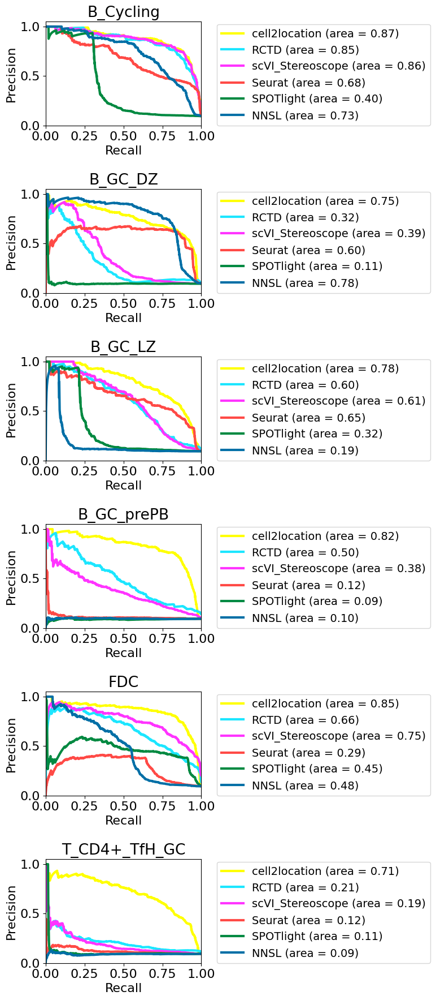

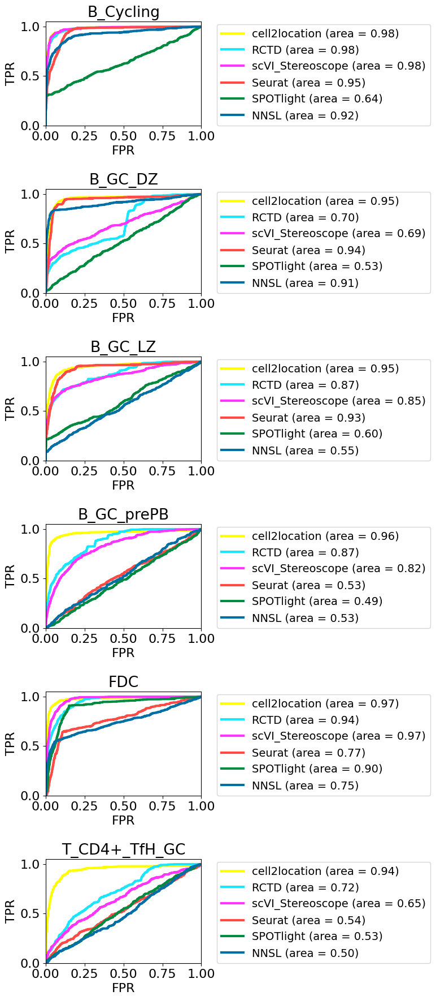

In [18]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (8,18), 'font.size': 16}):

    for c in ['PR', 'ROC']:
        for i, ct in enumerate(col_ind):

            plt.subplot(len(col_ind), 1, i+1)
            compare_precision_recall(pos_cell_count[:, np.isin(col_ind, ct)].reshape((pos_cell_count.shape[0], 1)), 
                                     [i[[ct]] for i in results],
                                     method_title=names, 
                                     legend_loc=(1.1, 0),
                                     curve=c
                                     #colors=['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal']
                                    )
            plt.tight_layout()
            plt.title(f'{ct}')
        plt.savefig(f'{fig_path}/{c}_comparison_all_cell_types.pdf')
        plt.show()

## Plot PR, ROC and spatial maps for selected cell types

In [19]:
col_ind

['B_Cycling', 'B_GC_DZ', 'B_GC_LZ', 'B_GC_prePB', 'FDC', 'T_CD4+_TfH_GC']

In [20]:
ct_sel = ['T_CD4+_TfH_GC', 'B_GC_prePB', 'B_Cycling']

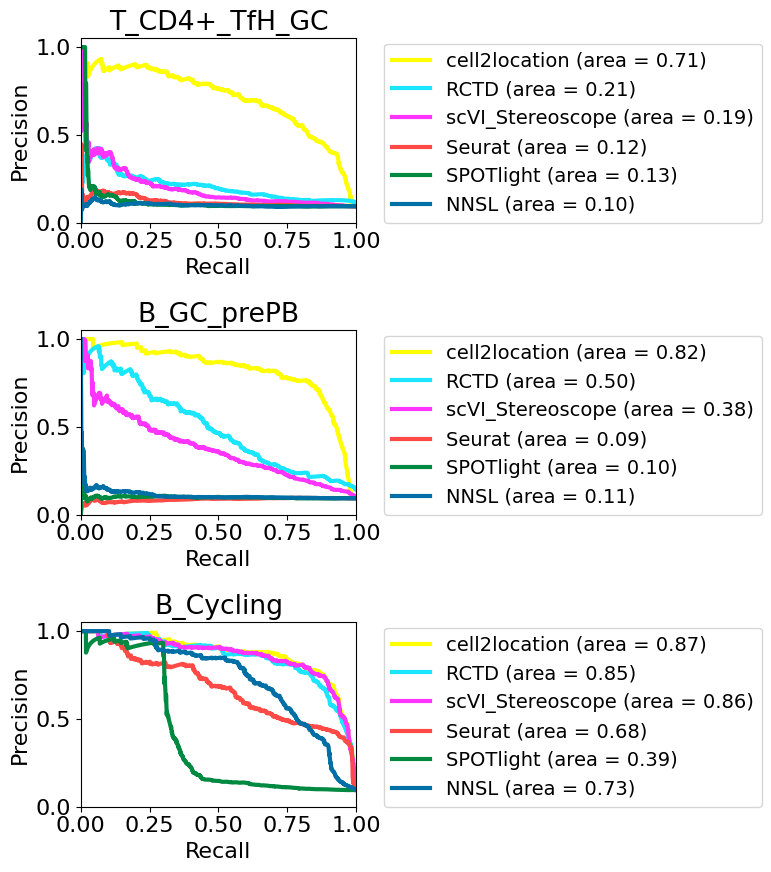

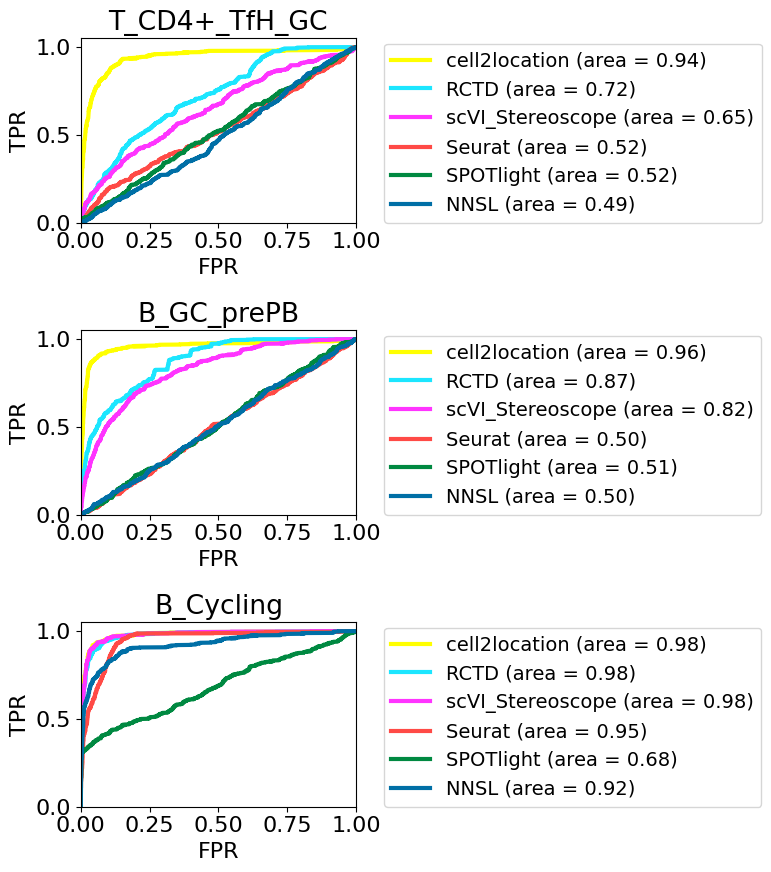

In [21]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (8,9), 'font.size': 16}):

    for c in ['PR', 'ROC']:
        for i, ct in enumerate(ct_sel):

            plt.subplot(len(ct_sel), 1, i+1)
            compare_precision_recall(pos_cell_count[:, np.isin(col_ind, ct)].reshape((pos_cell_count.shape[0], 1)), 
                                     [i[[ct]] for i in results],
                                     method_title=names, 
                                     legend_loc=(1.1, 0),
                                     curve=c
                                     #colors=['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal']
                                    )
            plt.tight_layout()
            plt.title(f'{ct}')
        plt.savefig(f'{fig_path}/{c}_comparison_selected_cell_types.pdf')
        plt.show()

In [22]:
[f'{m}_{ct}' for ct in ct_sel for m in names]

['cell2location_T_CD4+_TfH_GC',
 'RCTD_T_CD4+_TfH_GC',
 'scVI_Stereoscope_T_CD4+_TfH_GC',
 'Seurat_T_CD4+_TfH_GC',
 'SPOTlight_T_CD4+_TfH_GC',
 'NNSL_T_CD4+_TfH_GC',
 'cell2location_B_GC_prePB',
 'RCTD_B_GC_prePB',
 'scVI_Stereoscope_B_GC_prePB',
 'Seurat_B_GC_prePB',
 'SPOTlight_B_GC_prePB',
 'NNSL_B_GC_prePB',
 'cell2location_B_Cycling',
 'RCTD_B_Cycling',
 'scVI_Stereoscope_B_Cycling',
 'Seurat_B_Cycling',
 'SPOTlight_B_Cycling',
 'NNSL_B_Cycling']

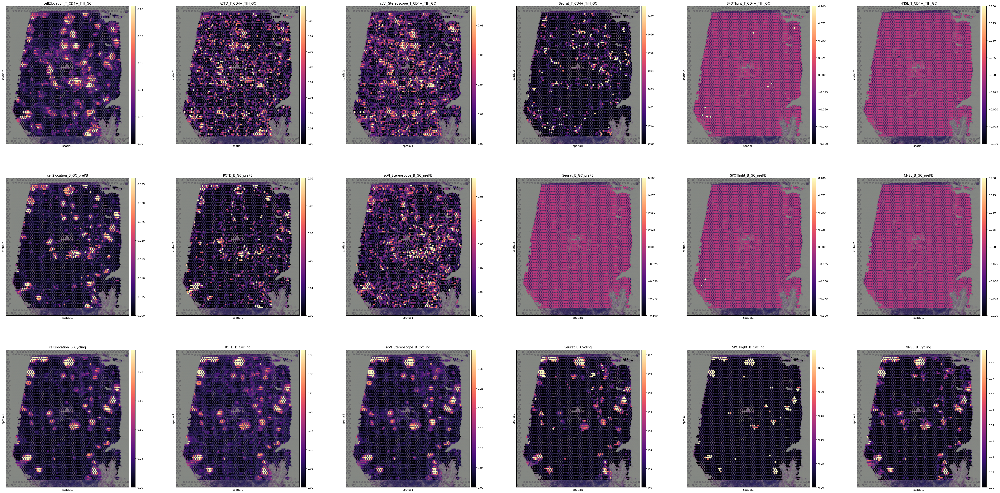

In [23]:
col_list=[f'{m}_{ct}' for ct in ct_sel for m in names]

fig_path = f'{results_folder}plots/figures/'
sc_figpath = sc.settings.figdir
sc.settings.figdir = f'{fig_path}'
with mpl.rc_context({'axes.facecolor':  'black',
                            'figure.figsize': [10, 10]}):
                
    sc.pl.spatial(adata_vis, cmap='magma',
                    color=col_list, ncols=6, #show=False,
                    #library_id=s,
                    size=1.3, img_key='hires', alpha_img=0.9, alpha=1,
                    frameon=True, legend_fontsize=50,
                    vmin=0, vmax='p98', save=f'benchmark_all_methods_selected_cell_types.png'
                 )

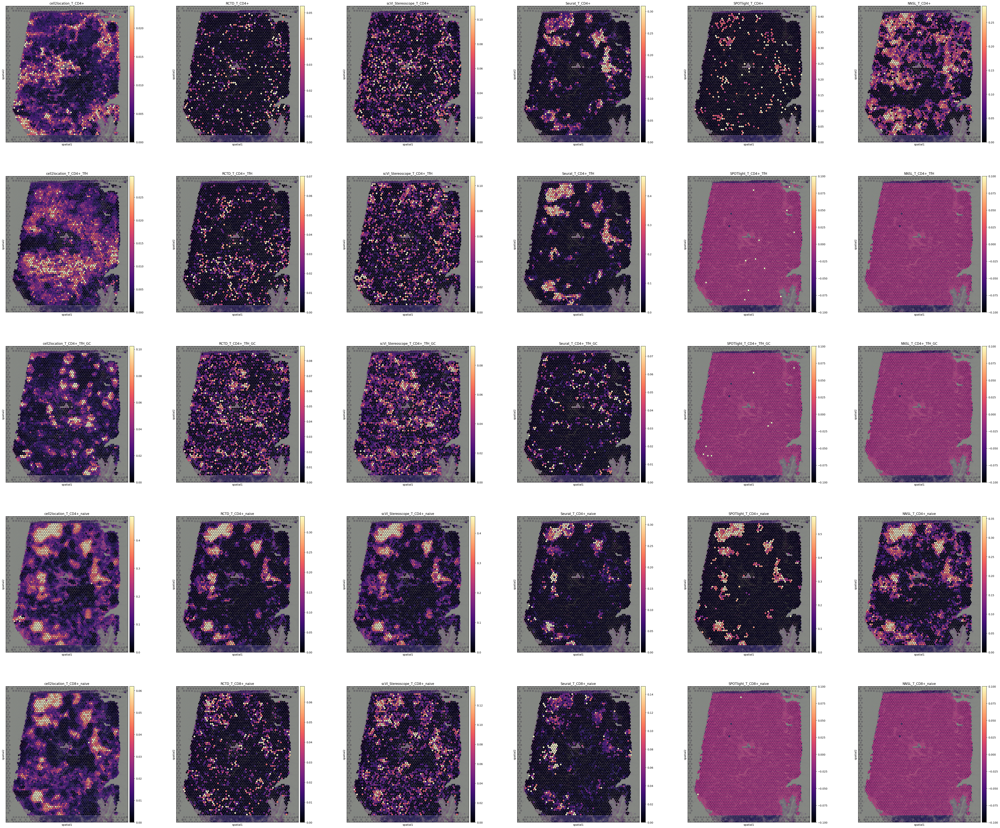

In [24]:
ct_sel = ['T_CD4+',
          'T_CD4+_TfH',
          'T_CD4+_TfH_GC',
          'T_CD4+_naive',
          'T_CD8+_naive']

col_list=[f'{m}_{ct}' for ct in ct_sel for m in names]

fig_path = f'{results_folder}plots/figures/'
sc_figpath = sc.settings.figdir
sc.settings.figdir = f'{fig_path}'
with mpl.rc_context({'axes.facecolor':  'black',
                            'figure.figsize': [10, 10]}):
                
    sc.pl.spatial(adata_vis, cmap='magma',
                    color=col_list, ncols=6, #show=False,
                    #library_id=s,
                    size=1.3, img_key='hires', alpha_img=0.9, alpha=1,
                    frameon=True, legend_fontsize=50,
                    vmin=0, vmax='p98', save=f'benchmark_all_methods_T_cells.png'
                 )

## Investigate txn differences between T_CD4+TfH & T_CD4+TfH_GC

In [40]:
reg_mod_name = 'RegressionNBV4Torch_57covariates_73260cells_10237genes'
reg_path = f'{results_folder}regression_model/{reg_mod_name}/'

adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')

adata_snrna_raw.raw.var['SYMBOL'] = adata_snrna_raw.raw.var.index
adata_snrna_raw.raw.var.index = adata_snrna_raw.raw.var['GeneID-2']
adata_snrna_raw.raw.var.index.name = None

adata_snrna_raw.var['SYMBOL'] = adata_snrna_raw.var.index
adata_snrna_raw.var.index = adata_snrna_raw.var['GeneID-2']
adata_snrna_raw.var.index.name = None

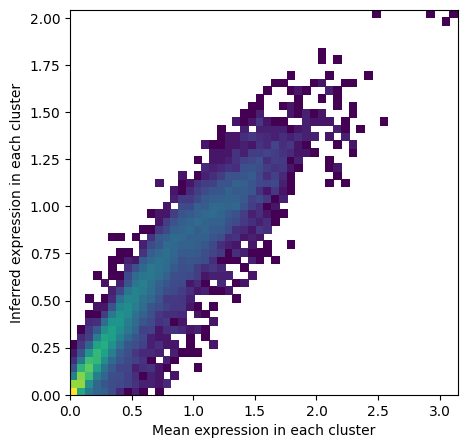

In [96]:
# export inferred averages in each cluster
inf_aver = adata_snrna_raw.var.copy()
inf_aver = inf_aver.loc[:, [f'mean_cov_effect_Subset_{i}' for i in adata_snrna_raw.obs['Subset'].unique()]]
from re import sub
inf_aver.columns = [sub(f'mean_cov_effect_Subset_{i}', '', i) for i in adata_snrna_raw.obs['Subset'].unique()]
inf_aver = inf_aver.iloc[:, inf_aver.columns.argsort()]

# scale up by average sample scaling factor
inf_aver = inf_aver * adata_snrna_raw.uns['regression_mod']['post_sample_means']['sample_scaling'].mean()

inf_aver = inf_aver.loc[adata_snrna_raw.raw.var['GeneID-2'], :]
inf_aver.index = adata_snrna_raw.raw.var_names

# compute mean expression of each gene in each cluster
aver = cell2location.cluster_averages.cluster_averages.get_cluster_averages(adata_snrna_raw, 'Subset')
aver = aver.loc[adata_snrna_raw.raw.var_names, inf_aver.columns]

with mpl.rc_context({'figure.figsize': [5, 5]}):
    plt.hist2d(np.log10(aver.values.flatten()+1), np.log10(inf_aver.values.flatten()+1),
               bins=50, norm=mpl.colors.LogNorm());
    plt.xlabel('Mean expression in each cluster');
    plt.ylabel('Inferred expression in each cluster');

In [43]:
inf_aver

,B_Cycling,B_GC_DZ,B_GC_LZ,B_GC_prePB,B_IFN,B_activated,B_mem,B_naive,B_plasma,B_preGC,...,T_CD4+_TfH,T_CD4+_TfH_GC,T_CD4+_naive,T_CD8+_CD161+,T_CD8+_cytotoxic,T_CD8+_naive,T_TIM3+,T_TfR,T_Treg,VSMC
ENSG00000188976,0.389986,0.214435,0.256271,2.956784e-01,1.257083e-01,0.147153,0.151172,0.122755,0.230796,3.209226e-01,...,0.111511,0.126056,0.166565,0.103764,0.094503,0.202703,0.310293,0.164446,0.131172,1.553225e-01
ENSG00000188290,0.001658,0.000012,0.000026,1.760481e-02,2.063625e-02,0.009338,0.027511,0.005316,0.000022,1.540930e-02,...,0.040316,0.031491,0.060974,0.014621,0.004839,0.018781,0.145339,0.304292,0.057148,1.146690e+00
ENSG00000187608,0.305257,0.138387,0.194006,3.523145e-01,4.158280e+00,0.075383,0.180887,0.068329,0.278930,6.063494e-02,...,0.176523,0.345447,0.309671,0.223379,0.255122,0.380937,1.813222,0.579268,0.279670,2.518890e-01
ENSG00000186891,0.016858,0.000055,0.048861,2.888634e-02,2.197197e-03,0.003020,0.002943,0.000163,0.117772,1.235234e-01,...,0.012353,0.309472,0.001328,0.049863,0.009768,0.000078,0.313490,0.922481,0.387692,1.563772e-09
ENSG00000186827,0.005551,0.000005,0.002945,7.722527e-03,5.199437e-03,0.000588,0.002372,0.000113,0.066400,3.887395e-02,...,0.125807,0.636628,0.028578,0.043257,0.011839,0.000788,0.511069,1.753242,0.793970,1.614110e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
IGL_VDJsum,9.948876,7.563540,3.652213,9.407078e+00,4.041258e+00,2.961928,3.139248,2.823470,109.727700,3.701239e+00,...,0.008561,0.015481,0.017801,0.025344,0.033933,0.004070,0.039067,0.027824,0.010213,1.616372e-02
TCRA_VDJsum,0.031178,0.001534,0.011304,5.098840e-02,4.094036e-10,0.000387,0.000389,0.000087,0.062889,7.492414e-04,...,2.594676,2.544148,2.547520,2.249395,2.027942,2.204234,4.086637,2.899816,3.444732,2.479343e-01
TCRB_VDJsum,0.051580,0.000504,0.002989,3.281814e-04,2.296285e-03,0.000485,0.002994,0.000680,0.106378,3.955359e-04,...,3.988787,6.722402,3.845822,2.744595,3.262480,3.290963,7.399317,7.432308,4.821861,1.205301e-01
TCRD_VDJsum,0.000339,0.001759,0.002099,9.781692e-10,5.895333e-10,0.000099,0.000496,0.000015,0.000500,3.789579e-10,...,0.041513,0.019695,0.034700,0.198152,0.095711,0.058952,0.015891,0.017350,0.028833,1.754361e-09


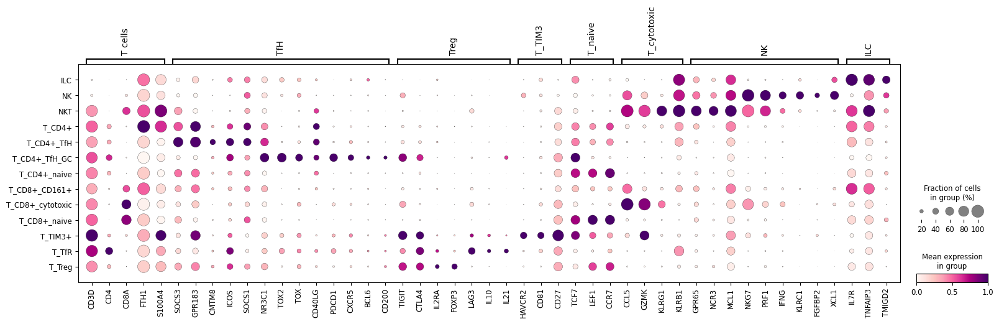

In [102]:
tcell_names = ['T_CD4+',
'T_CD4+_TfH',
'T_CD4+_TfH_GC',
'T_Treg',
'T_TfR',
'T_TIM3+',
'T_CD4+_naive',
    'T_CD8+_naive',
    'T_CD8+_cytotoxic',
'T_CD8+_CD161+',
'NKT',
'NK',
'ILC']
tcells = adata_snrna_raw[adata_snrna_raw.obs['Subset'].isin(tcell_names)]

marker_genes_dict = {
'T cells': ["CD3D",  "CD4", "CD8A", "FTH1", "S100A4"],
'TfH': ["SOCS3", "GPR183", "CMTM8","ICOS", "SOCS1", "NR3C1","TOX2", "TOX",
        "CD40LG", "PDCD1", "CXCR5", "BCL6", "CD200"],
'Treg': ["TIGIT", "CTLA4", "IL2RA","FOXP3", "LAG3", "IL10", "IL21"],
'T_TIM3': ["HAVCR2", "CD81", "CD27"],
'T_naive': ['TCF7', "LEF1", "CCR7"],
'T_cytotoxic': ["CCL5",'GZMK',  "KLRG1",  "KLRB1"],
'NK': ["GPR65","NCR3","MCL1", "NKG7","PRF1", "IFNG","KLRC1", "FGFBP2", "XCL1"],
'ILC': ["IL7R", "TNFAIP3",  "TMIGD2"]
}

with mpl.rc_context({'figure.figsize': [10, 3]}):
    ax = sc.pl.dotplot(tcells, marker_genes_dict, groupby='Subset', dendrogram=False, 
                       standard_scale='var', use_raw=True, cmap="RdPu", gene_symbols='SYMBOL')

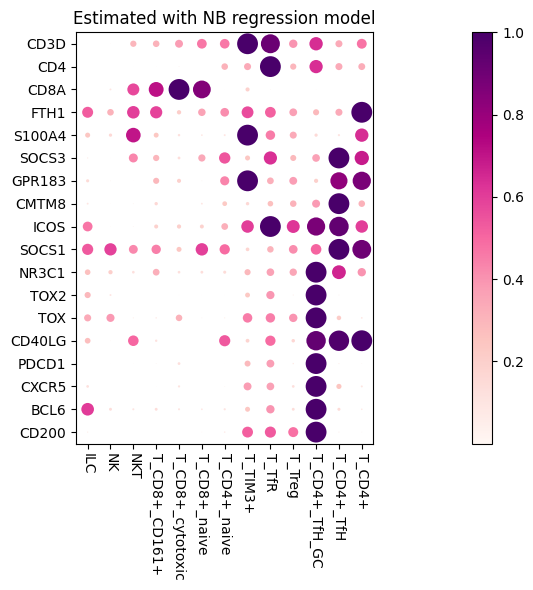

In [103]:
from cell2location.plt.plot_heatmap import dotplot

t_sel_mark = list(marker_genes_dict['T cells']) + list(marker_genes_dict['TfH'])
gene_ind = adata_snrna_raw.var['SYMBOL'].isin(t_sel_mark)
inf_aver_subset = inf_aver.loc[gene_ind, :]
inf_aver_subset.index = adata_snrna_raw.var['SYMBOL'][gene_ind]
inf_aver_subset = inf_aver_subset.loc[t_sel_mark, tcell_names]
inf_aver_subset_norm = (inf_aver_subset.T / inf_aver_subset.max(1)).T

dotplot(inf_aver_subset_norm, array_size=inf_aver_subset_norm.values, ticks=False, 
        log=False, figsize=[20, 6], 
        equal=True, 
        row_labels=inf_aver_subset_norm.index, 
        col_labels=inf_aver_subset_norm.columns,
        cbar=True, cmap='RdPu', title='Estimated with NB regression model')

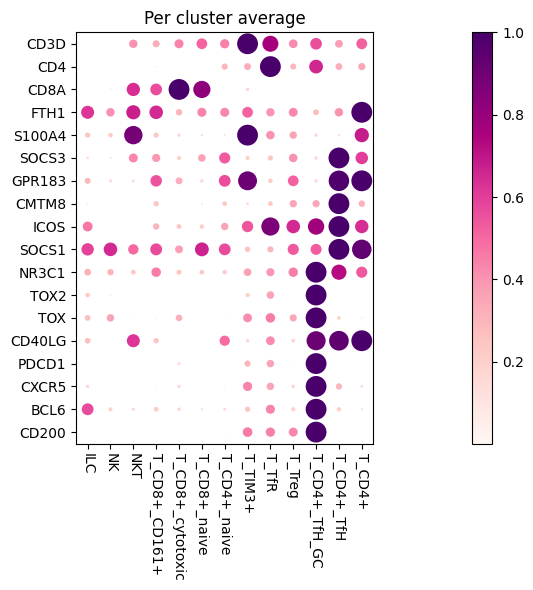

In [104]:
from cell2location.plt.plot_heatmap import dotplot

t_sel_mark = list(marker_genes_dict['T cells']) + list(marker_genes_dict['TfH'])
gene_ind = adata_snrna_raw.var['SYMBOL'].isin(t_sel_mark)
aver_subset = aver.loc[gene_ind, :]
aver_subset.index = adata_snrna_raw.var['SYMBOL'][gene_ind]
aver_subset = aver_subset.loc[t_sel_mark, tcell_names]
aver_subset_norm = (aver_subset.T / aver_subset.max(1)).T

dotplot(aver_subset_norm, array_size=aver_subset_norm.values, ticks=False, 
        log=False, figsize=[20, 6], 
        equal=True, 
        row_labels=aver_subset_norm.index, 
        col_labels=aver_subset_norm.columns,
        cbar=True, cmap='RdPu', title='Per cluster average')

In [105]:
max_val_df = pd.DataFrame()
max_val_df['aver_subset'] = aver_subset['T_CD4+_TfH_GC']#.max(1)
max_val_df['inf_aver'] = inf_aver_subset['T_CD4+_TfH_GC']#.max(1)
max_val_df['diff'] = max_val_df['aver_subset'] / max_val_df['inf_aver']
max_val_df

,aver_subset,inf_aver,diff
SYMBOL,,,
CD3D,3.926079,6.376461,0.615714
CD4,0.609084,0.632323,0.963249
CD8A,0.057487,0.057943,0.992137
FTH1,6.764024,2.728031,2.479453
S100A4,1.813024,1.670550,1.085286
SOCS3,0.380235,0.560753,0.678079
GPR183,0.555433,0.712976,0.779035
CMTM8,0.172462,0.179282,0.961960
ICOS,0.882011,1.065499,0.827791


In [215]:
most_different = (aver['T_CD4+_TfH'] - inf_aver['T_CD4+_TfH']).sort_values()
most_different.index = adata_snrna_raw.var.loc[most_different.index, 'SYMBOL']
most_different = most_different[~np.array(['RP' in i for i in most_different.index])]

most_different_GC = (aver['T_CD4+_TfH_GC'] - inf_aver['T_CD4+_TfH_GC']).sort_values()
most_different_GC.index = adata_snrna_raw.var.loc[most_different_GC.index, 'SYMBOL']
most_different_GC = most_different_GC[~np.array(['RP' in i for i in most_different_GC.index])]
#most_different_sorted = (most_different / most_different_GC[most_different.index]).sort_values()

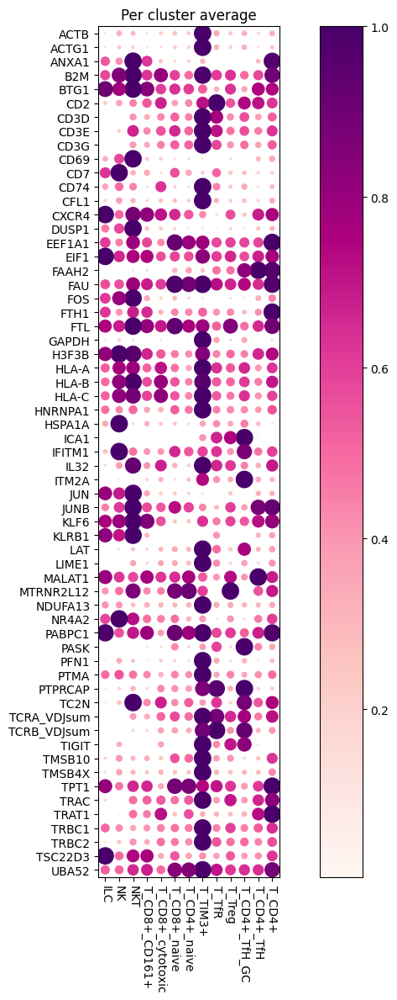

In [221]:
from cell2location.plt.plot_heatmap import dotplot

gene_names = list(most_different.tail(30).index) + list(most_different.head(15).index)
gene_names = gene_names + list(most_different_GC.tail(30).index) + list(most_different_GC.head(15).index)
gene_names = np.unique(gene_names)
gene_ind = adata_snrna_raw.var['SYMBOL'].isin(gene_names)
aver_subset = aver.loc[gene_ind, :]
aver_subset.index = adata_snrna_raw.var['SYMBOL'][gene_ind]
aver_subset = aver_subset.loc[gene_names, tcell_names]
aver_subset_norm = (aver_subset.T / aver_subset.max(1)).T

dotplot(aver_subset_norm, array_size=aver_subset_norm.values, ticks=False, 
        log=False, figsize=[10, 12], 
        equal=True, 
        row_labels=aver_subset_norm.index, 
        col_labels=aver_subset_norm.columns,
        cbar=True, cmap='RdPu', title='Per cluster average')

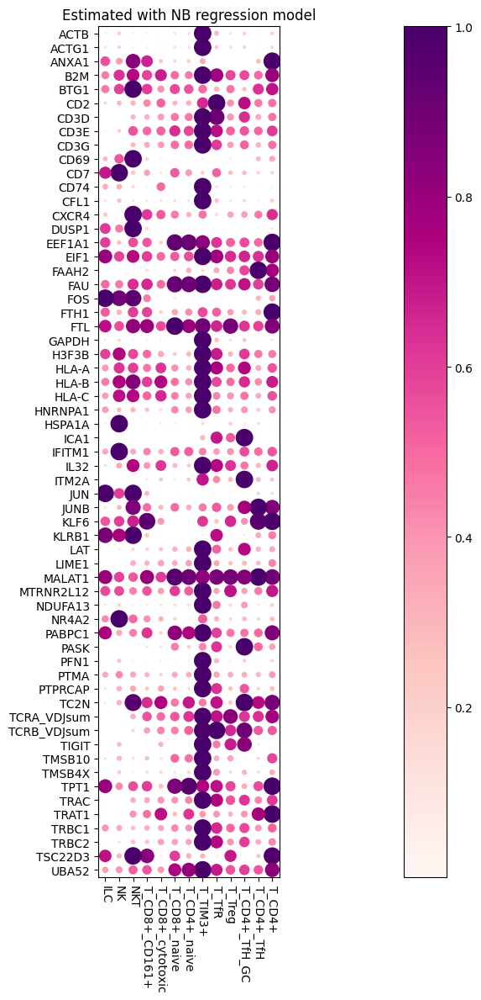

In [217]:
from cell2location.plt.plot_heatmap import dotplot

inf_aver_subset = inf_aver.loc[gene_ind, :]
inf_aver_subset.index = adata_snrna_raw.var['SYMBOL'][gene_ind]
inf_aver_subset = inf_aver_subset.loc[gene_names, tcell_names]
inf_aver_subset_norm = (inf_aver_subset.T / inf_aver_subset.max(1)).T

dotplot(inf_aver_subset_norm, array_size=inf_aver_subset_norm.values, ticks=False, 
        log=False, figsize=[30, 12], 
        equal=True, 
        row_labels=inf_aver_subset_norm.index, 
        col_labels=inf_aver_subset_norm.columns,
        cbar=True, cmap='RdPu', title='Estimated with NB regression model')

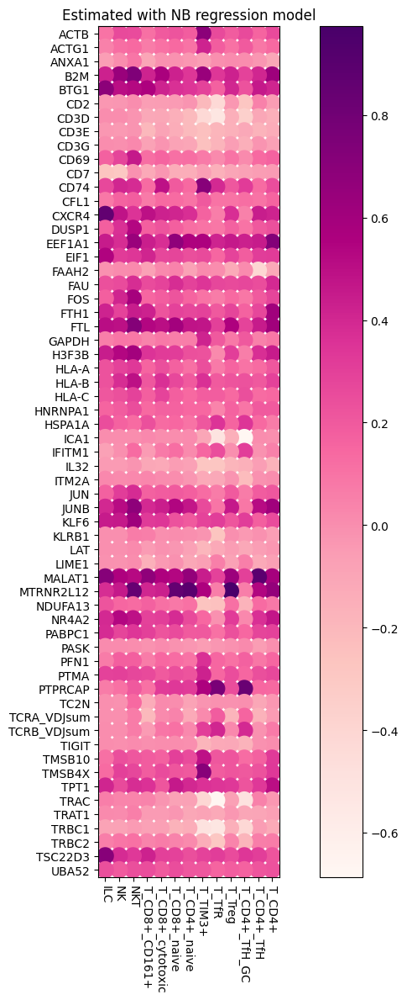

In [218]:
from cell2location.plt.plot_heatmap import dotplot
diff = ((aver_subset - inf_aver_subset).T / aver_subset.max(1)).T
dotplot(diff, 
        array_size=np.ones_like(aver_subset), 
        ticks=False, log=False, figsize=[10, 12], 
        equal=True, 
        row_labels=inf_aver_subset_norm.index, 
        col_labels=inf_aver_subset_norm.columns,
        cbar=True, cmap='RdPu', title='Estimated with NB regression model')

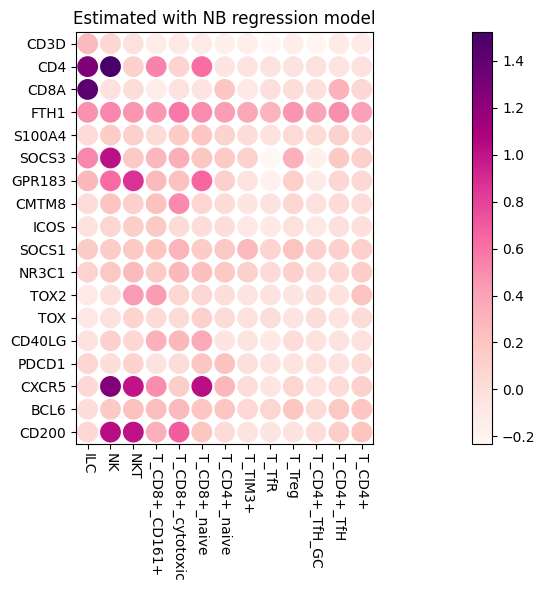

In [109]:
from cell2location.plt.plot_heatmap import dotplot

dotplot(np.log10(aver_subset / inf_aver_subset), 
        array_size=np.ones_like(aver_subset), ticks=False, 
        log=False, figsize=[20, 6], 
        equal=True, 
        row_labels=inf_aver_subset.index, 
        col_labels=inf_aver_subset.columns,
        cbar=True, cmap='RdPu', title='Estimated with NB regression model')

In [110]:
total = pd.DataFrame()
total['inf_aver'] = inf_aver[tcell_names].sum()
total['aver'] = aver[tcell_names].sum()
total['diff'] = total['aver'] / total['inf_aver']

total, total['diff'].mean()

(                     inf_aver         aver      diff
 T_CD4+            2536.660142  4334.893363  1.708898
 T_CD4+_TfH        1703.644098  3209.492669  1.883899
 T_CD4+_TfH_GC     2152.434444  3198.010911  1.485765
 T_Treg            1895.745320  3258.720704  1.718965
 T_TfR             2496.326103  3397.143356  1.360857
 T_TIM3+           4807.149724  6193.706899  1.288436
 T_CD4+_naive      2165.968739  3640.810917  1.680916
 T_CD8+_naive      2270.324209  3963.082712  1.745602
 T_CD8+_cytotoxic  1536.447194  2954.708437  1.923078
 T_CD8+_CD161+     1865.603507  3310.151466  1.774306
 NKT               2030.154089  3956.270464  1.948754
 NK                2206.733751  3677.687866  1.666575
 ILC               1991.921840  3367.063461  1.690359,
 1.682800825217713)

(1.132513978051341, 2.2014709135161556)

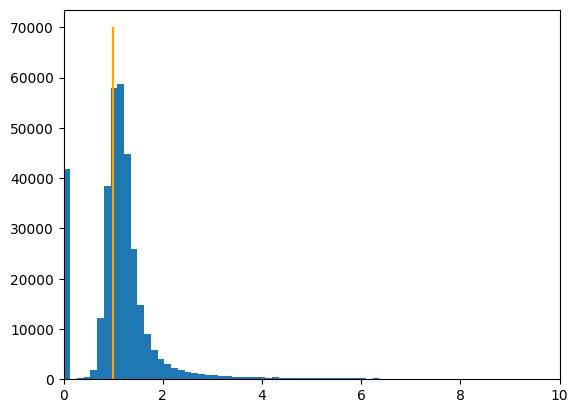

In [122]:
plt.hist((aver / inf_aver).values.flatten(), bins=1000);
plt.xlim(0,10);
plt.vlines(1, 0, 70000, color='orange');
np.median((aver / inf_aver).values), np.mean((aver / inf_aver).values)

Modules and their versions used for this analysis

In [24]:
import sys
for module in sys.modules:
    try:
        print(module,sys.modules[module].__version__)
    except:
        try:
            if  type(sys.modules[module].version) is str:
                print(module,sys.modules[module].version)
            else:
                print(module,sys.modules[module].version())
        except:
            try:
                print(module,sys.modules[module].VERSION)
            except:
                pass


sys 3.7.8 | packaged by conda-forge | (default, Jul 31 2020, 02:25:08) 
[GCC 7.5.0]
ipykernel 5.3.4
ipykernel._version 5.3.4
json 2.0.9
re 2.2.1
IPython 7.18.1
IPython.core.release 7.18.1
logging 0.5.1.2
zlib 1.0
traitlets 5.0.4
traitlets._version 5.0.4
argparse 1.1
ipython_genutils 0.2.0
ipython_genutils._version 0.2.0
platform 1.0.8
IPython.core.crashhandler 7.18.1
pygments 2.7.1
pexpect 4.8.0
ptyprocess 0.6.0
decorator 4.4.2
pickleshare 0.7.5
backcall 0.2.0
sqlite3 2.6.0
sqlite3.dbapi2 2.6.0
_sqlite3 2.6.0
prompt_toolkit 3.0.7
wcwidth 0.2.5
jedi 0.17.2
parso 0.7.1
colorama 0.4.3
ctypes 1.1.0
_ctypes 1.1.0
urllib.request 3.7
jupyter_client 6.1.7
jupyter_client._version 6.1.7
zmq 19.0.2
zmq.backend.cython 40302
zmq.backend.cython.constants 40302
zmq.sugar 19.0.2
zmq.sugar.constants 40302
zmq.sugar.version 19.0.2
jupyter_core 4.6.3
jupyter_core.version 4.6.3
distutils 3.7.8
tornado 6.0.4
_curses b'2.2'
dateutil 2.8.1
dateutil._version 2.8.1
six 1.15.0
decimal 1.70
_decimal 1.70
scanpy 